<a href="https://colab.research.google.com/github/prakharbanga/AIPlane/blob/main/AIPlane_ProGAN_%2B_Spectral_Norm.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
WHICH_GAN = "airplane"

In [ ]:
!pip install -q clu

In [ ]:
import tensorflow as tf
import tensorflow_datasets as tfds
import jax
import jax.numpy as jnp
from jax.tree_util import tree_flatten
from flax import linen as nn, struct
from flax.training import train_state
from flax.core import frozen_dict
from flax.serialization import (to_state_dict, msgpack_serialize, from_bytes)
import optax
from clu import metrics
import functools
import numpy as np
from PIL import Image
from torch.utils.tensorboard import SummaryWriter
import time
import random
import matplotlib.pyplot as plt
from typing import Any, Optional
import glob
import os
import IPython.display as display

In [ ]:
assert tf.test.gpu_device_name() == "/device:GPU:0", "GPU not found!"
print(f"Found {jax.device_count()} devices of type {jax.devices()[0].device_kind}")

num_devices = jax.device_count()
device_type = jax.devices()[0].device_kind

print(f"Found {num_devices} JAX devices of type {device_type}.")
# assert "TPU" in device_type, "Available device is not a TPU, please select TPU from Edit > Notebook settings > Hardware accelerator"

Found 1 devices of type Tesla T4
Found 1 JAX devices of type Tesla T4.


In [ ]:
labels = [
  "airplane",
  "automobile",
  "bird",
  "cat",
  "deer",
  "dog",
  "frog",
  "horse",
  "ship",
  "truck",
]

LATENT_DIM = 100

In [ ]:
def image_to_input(image):
  return 2. * image / 255. - 1.

def input_to_image(input):
  return (input + 1.) * 255. / 2.

## Download FGVC Aircraft Dataset

In [ ]:
!wget -nc https://www.robots.ox.ac.uk/~vgg/data/fgvc-aircraft/archives/fgvc-aircraft-2013b.tar.gz

File ‘fgvc-aircraft-2013b.tar.gz’ already there; not retrieving.



In [ ]:
!mkdir /content/fgvc-aircraft-2013b/
if not glob.glob("fgvc-aircraft-2013b/fgvc-aircraft-2013b/data/images"):
  !tar -xvkf "/content/fgvc-aircraft-2013b.tar.gz" -C "/content/fgvc-aircraft-2013b/"     #[run this cell to extract tar files]

mkdir: cannot create directory ‘/content/fgvc-aircraft-2013b/’: File exists


In [ ]:
!mkdir -p fgvc-aircraft-2013b-resized/fgvc-aircraft-2013b/data/images

for image_file in glob.glob("fgvc-aircraft-2013b/fgvc-aircraft-2013b/data/images/*.jpg"):
  new_image_file = "fgvc-aircraft-2013b-resized/" + "/".join(image_file.split('/')[1:])
  if glob.glob(new_image_file):
    continue
  with Image.open(image_file) as image:
    image.resize((32, 32)).save(new_image_file)

In [ ]:
def concat(dss):
  return functools.reduce(lambda x, y: x.concatenate(y), dss)

def split_dataset(dataset, *args):
  cumsplits = np.cumsum(args).tolist()
  total = cumsplits[-1]
  return [concat([dataset.shard(total, split) for split in range(start, end)]) for (start, end) in zip([0] + cumsplits, cumsplits)]

def get_datasets(num_epochs, batch_size):
  sample_fn = lambda sample: tf.image.resize(image_to_input(tf.cast(sample, tf.float32)), [32, 32])

  gan_index = labels.index(WHICH_GAN)

  (fgvc_train_ds, fgvc_test_ds) = split_dataset(tf.keras.utils.image_dataset_from_directory("/content/fgvc-aircraft-2013b-resized", batch_size=batch_size), 90, 10)
  (cifar_train_ds, cifar_test_ds) = (tfds.load('cifar10', split='train').filter(lambda elem: elem['label'] == gan_index).map(lambda x: x['image']).batch(batch_size, drop_remainder=True).shuffle(batch_size),
                                     tfds.load('cifar10', split='test').filter(lambda elem: elem['label'] == gan_index).map(lambda x: x['image']).batch(batch_size, drop_remainder=True).shuffle(batch_size))

  train_ds = concat([fgvc_train_ds.map(lambda x, y: x).map(sample_fn), cifar_train_ds.map(sample_fn)]).cache()
  test_ds = concat([fgvc_test_ds.map(lambda x, y: x).map(sample_fn), cifar_test_ds.map(sample_fn)]).cache()

  train_ds = train_ds.repeat(num_epochs)
  test_ds = test_ds
  return (train_ds.prefetch(tf.data.AUTOTUNE), test_ds.prefetch(tf.data.AUTOTUNE))

In [ ]:
num_epochs = 10_000_000
batch_size = 64
if 'train_ds' not in globals() or 'test_ds' not in globals():
  (train_ds, test_ds) = get_datasets(num_epochs, batch_size)
assert(not any([batch for batch in test_ds.as_numpy_iterator() if batch.shape[1:] != (32, 32, 3)]))

In [ ]:
REAL_LABEL = 0
FAKE_LABEL = 1

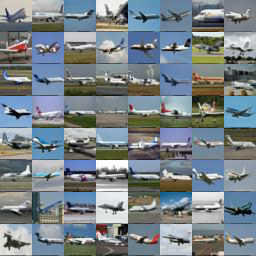

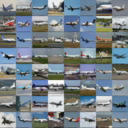

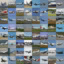

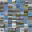

In [ ]:
elems = list(train_ds.take(1).get_single_element())

def gridify(grid):
  return np.transpose(grid.reshape((8, 8, 32, 32, 3)), axes=(0, 2, 1, 3, 4)).reshape(8*32, 8*32, 3)

display.display(Image.fromarray(input_to_image(gridify(np.array([elem.numpy() for elem in elems]))).astype(np.uint8)))
display.display(Image.fromarray(np.array(jax.image.resize(jnp.array(input_to_image(gridify(np.array([elem.numpy() for elem in elems]))).astype(np.uint8)), method="linear", shape=(128, 128, 3)).astype(np.uint8))))
display.display(Image.fromarray(np.array(jax.image.resize(jnp.array(input_to_image(gridify(np.array([elem.numpy() for elem in elems]))).astype(np.uint8)), method="linear", shape=(64, 64, 3)).astype(np.uint8))))
display.display(Image.fromarray(np.array(jax.image.resize(jnp.array(input_to_image(gridify(np.array([elem.numpy() for elem in elems]))).astype(np.uint8)), method="linear", shape=(32, 32, 3)).astype(np.uint8))))

## Spectral Norm Module (borrowed from Haiku)

In [ ]:
# Original Source: https://github.com/deepmind/dm-haiku/blob/main/haiku/_src/spectral_norm.py

def _l2_normalize(x, axis=None, eps=1e-12):
  """Normalizes along dimension `axis` using an L2 norm.

  This specialized function exists for numerical stability reasons.

  Args:
    x: An input ndarray.
    axis: Dimension along which to normalize, e.g. `1` to separately normalize
      vectors in a batch. Passing `None` views `t` as a flattened vector when
      calculating the norm (equivalent to Frobenius norm).
    eps: Epsilon to avoid dividing by zero.

  Returns:
    An array of the same shape as 'x' L2-normalized along 'axis'.
  """
  return x * jax.lax.rsqrt((x * x).sum(axis=axis, keepdims=True) + eps)


class SpectralNorm(nn.Module):
  """Normalizes an input by its first singular value.

  This module uses power iteration to calculate this value based on the
  input and an internal hidden state.

  update_stats: A boolean defaulting to True. Regardless of this arg, this
    function will return the normalized input. When
    `update_stats` is True, the internal state of this object will also be
    updated to reflect the input value. When `update_stats` is False the
    internal stats will remain unchanged.
  error_on_non_matrix: Spectral normalization is only defined on matrices.
    By default, this module will return scalars unchanged and flatten
    higher-order tensors in their leading dimensions. Setting this flag to
    True will instead throw errors in those cases.

  """

  wrapped: nn.Module
  update_stats: bool = True
  error_on_non_matrix: bool = False
  eps: float = 1e-4
  n_steps: int = 1

  @nn.compact
  def __call__(
      self,
      value: jax.Array
  ) -> jax.Array:
    """Wraps a layer with Spectral Normalization.

    Args:
      value: The value (Array-like) for which you would like to perform an
        spectral normalization after the wrapped layer.
    Returns:
      The output of the wrapped layer normalized by it's first singular value.
    Raises:
      ValueError: If `error_on_non_matrix` is True and `value` has ndims > 2.
    """

    u0 = self.variable(
        'spectral_norm_stats', 'u0', lambda s: jnp.ones(s, jnp.float32), (1, self.wrapped.features)
    )

    if 'params' not in self.wrapped.variables or 'kernel' not in self.wrapped.variables['params']:
      return self.wrapped(value)

    kernel = self.wrapped.variables['params']['kernel']

    # Handle scalars.
    if kernel.ndim <= 1:
      raise ValueError("Spectral normalization is not well defined for "
                       "scalar or vector inputs.")
    # Handle higher-order tensors.
    elif kernel.ndim > 2:
      if self.error_on_non_matrix:
        raise ValueError(
            f"Input is {kernel.ndim}D but error_on_non_matrix is True")
      else:
        kernel = jnp.reshape(kernel, [-1, kernel.shape[-1]])

    u0_val = u0.value

    # Power iteration for the weight's singular value.
    for _ in range(self.n_steps):
      v0_val = _l2_normalize(jnp.matmul(u0_val, kernel.transpose([1, 0])), eps=self.eps)
      u0_val = _l2_normalize(jnp.matmul(v0_val, kernel), eps=self.eps)

    u0_val = jax.lax.stop_gradient(u0_val)
    v0_val = jax.lax.stop_gradient(v0_val)

    sigma = jnp.matmul(jnp.matmul(v0_val, kernel), jnp.transpose(u0_val))[0, 0]

    if self.update_stats:
      u0.value = u0_val

    return self.wrapped(value) / (sigma + 1e-8)

## End of Spectral Norm

## Local Response Normalization

In [ ]:
class LocalResponseNorm(nn.Module):
  @nn.compact
  def __call__(
      self,
      value: jax.Array
  ) -> jax.Array:
    return value / jnp.repeat(jnp.expand_dims((1e-8 + (value**2).mean(axis=-1))**0.5, axis=-1), repeats=value.shape[-1], axis=-1)

## End of Local Response Normalization

In [ ]:
EPSILON = 1e-8

class Discriminator(nn.Module):
  @nn.compact
  def __call__(self, x32, x16, x8, x4, alpha32, alpha16, alpha8, alpha4, training=True):
    x32 = SpectralNorm(nn.Conv(features=32, kernel_size=(3, 3), strides=(2, 2)), update_stats=training)(x32) # batch x 16 x 16 x 32
    x32 = nn.leaky_relu(x32, negative_slope=0.2)
    x16 = SpectralNorm(nn.Conv(features=32, kernel_size=(3, 3)), update_stats=training)(x16)
    x16 = SpectralNorm(nn.Conv(features=64, kernel_size=(3, 3), strides=(2, 2)), update_stats=training)((alpha32*x32 + alpha16*x16) / (alpha32+alpha16+EPSILON)) # batch x 8 x 8 x 64
    x16 = nn.leaky_relu(x16, negative_slope=0.2)
    x8 = SpectralNorm(nn.Conv(features=64, kernel_size=(3, 3)), update_stats=training)(x8)
    x8 = SpectralNorm(nn.Conv(features=128, kernel_size=(3, 3), strides=(2, 2)), update_stats=training)(((alpha32+alpha16)*x16 + alpha8*x8) / (alpha32+alpha16+alpha8+EPSILON)) # batch x 4 x 4 x 128
    x8 = nn.leaky_relu(x8, negative_slope=0.2)
    x4 = SpectralNorm(nn.Conv(features=128, kernel_size=(3, 3)), update_stats=training)(x4)
    x4 = SpectralNorm(nn.Conv(features=256, kernel_size=(3, 3), strides=(2, 2)), update_stats=training)(((alpha32+alpha16+alpha8)*x8 + alpha4*x4))  # batch x 2 x 2 x 256
    x = nn.leaky_relu(x4, negative_slope=0.2)
    x = x.reshape((x.shape[0], -1)) # flatten - batch*2*2*256
    # x = nn.Dropout(0.01, deterministic=not training)(x) # Dropout seems to break Spectral Norm
    x = jnp.concatenate([x, jnp.expand_dims(jnp.sum(jnp.abs(x - jnp.repeat(jnp.expand_dims(jnp.mean(x, axis=0), axis=0), repeats=x.shape[0], axis=0)), axis=1), axis=1)], axis=1) # minibatch discrimination
    x = SpectralNorm(nn.Dense(features=32), update_stats=training)(x)
    x = nn.leaky_relu(x, negative_slope=0.2)
    x = SpectralNorm(nn.Dense(features=1), update_stats=training)(x)
    return x

class Generator(nn.Module):
  @nn.compact
  def __call__(self, latent, training=True):
    x = nn.Dense(features=32)(latent)
    # x = nn.BatchNorm(not training)(x)
    x = nn.relu(x)
    x = nn.Dense(features=2*2*256)(x)
    x = nn.BatchNorm(not training)(x)
    x = nn.relu(x)
    x = nn.Dropout(0.5, deterministic=not training)(x)
    x = x.reshape((x.shape[0], 2, 2, -1))
    x4o = nn.ConvTranspose(features=3, kernel_size=(2, 2), strides=(2, 2))(x)
    x4 = nn.ConvTranspose(features=128, kernel_size=(2, 2), strides=(2, 2))(x)
    x4 = LocalResponseNorm()(x4)
    # x4 = nn.BatchNorm(not training)(x4)
    x8 = nn.relu(x4)
    # x8 = nn.Dropout(0.5, deterministic=not training)(x8)
    x8o = nn.ConvTranspose(features=3, kernel_size=(2, 2), strides=(2, 2))(x8)
    x8 = nn.ConvTranspose(features=64, kernel_size=(2, 2), strides=(2, 2))(x8)
    x8 = LocalResponseNorm()(x8)
    # x8 = nn.BatchNorm(not training)(x8)
    x16 = nn.relu(x8)
    # x16 = nn.Dropout(0.5, deterministic=not training)(x16)
    x16o = nn.ConvTranspose(features=3, kernel_size=(2, 2), strides=(2, 2))(x16)
    x16 = nn.ConvTranspose(features=32, kernel_size=(2, 2), strides=(2, 2))(x16)
    x16 = LocalResponseNorm()(x16)
    # x16 = nn.BatchNorm(not training)(x16)
    x32 = nn.relu(x16)
    # x32 = nn.Dropout(0.5, deterministic=not training)(x32)
    x32o = nn.ConvTranspose(features=3, kernel_size=(2, 2), strides=(2, 2))(x32)
    return (nn.tanh(x32o), nn.tanh(x16o), nn.tanh(x8o), nn.tanh(x4o))

In [ ]:
discriminator = Discriminator()
generator = Generator()
print(generator.tabulate({'params': jax.random.PRNGKey(0), 'dropout': jax.random.PRNGKey(0)}, jnp.zeros((batch_size, LATENT_DIM)), console_kwargs={'width': 120}))
print(discriminator.tabulate({'params': jax.random.PRNGKey(0), 'dropout': jax.random.PRNGKey(0)}, jnp.ones((batch_size, 32, 32, 3)), jnp.ones((batch_size, 16, 16, 3)), jnp.ones((batch_size, 8, 8, 3)), jnp.ones((batch_size, 4, 4, 3)), 1., 0., 0., 0., console_kwargs={'width': 120}))


                                                   Generator Summary                                                    
┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━┓
┃ path              ┃ module            ┃ inputs            ┃ outputs           ┃ batch_stats       ┃ params           ┃
┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━┩
│                   │ Generator         │ float32[64,100]   │ -                 │                   │                  │
│                   │                   │                   │ float32[64,32,32… │                   │                  │
│                   │                   │                   │ -                 │                   │                  │
│                   │                   │                   │ float32[64,16,16… │                   │                  │
│                   │          

In [ ]:
@struct.dataclass
class DiscMetrics(metrics.Collection):
  accuracy: metrics.Accuracy
  loss: metrics.Average.from_output('loss')
  prediction: metrics.Average.from_output('prediction')

@struct.dataclass
class GenMetrics(metrics.Collection):
  accuracy: metrics.Accuracy
  loss: metrics.Average.from_output('loss')
  prediction: metrics.Average.from_output('prediction')

In [ ]:
class DiscriminatorTrainState(train_state.TrainState):
  metrics: DiscMetrics
  spectral_norm_stats: Any
  dropout_key: jax.random.KeyArray
  latent_key: jax.random.KeyArray

def create_disc_train_state(module, rng, optim, args_fn, alphas):
  main_key, params_key, dropout_key, latent_key = jax.random.split(rng, num=4)
  variables = module.init(params_key, *args_fn(main_key), *alphas, training=False)
  params = variables['params']
  spectral_norm_stats = variables['spectral_norm_stats']
  return DiscriminatorTrainState.create(
      apply_fn=module.apply, params=params, spectral_norm_stats=spectral_norm_stats, tx=optim,
      dropout_key=dropout_key, latent_key=latent_key, metrics=DiscMetrics.empty())

class GeneratorTrainState(train_state.TrainState):
  metrics: GenMetrics
  batch_stats: Any
  dropout_key: jax.random.KeyArray
  latent_key: jax.random.KeyArray

def create_gen_train_state(module, rng, optim, args_fn):
  main_key, params_key, dropout_key, latent_key = jax.random.split(rng, num=4)
  variables = module.init(params_key, args_fn(main_key), training=False)
  params = variables['params']
  batch_stats = variables['batch_stats']
  return GeneratorTrainState.create(
      apply_fn=module.apply, params=params, batch_stats=batch_stats, tx=optim,
      dropout_key=dropout_key, latent_key=latent_key, metrics=GenMetrics.empty())

In [ ]:
def sample_latent(batch_size, key):
  return jax.random.normal(key, shape=(batch_size, LATENT_DIM))

In [ ]:
@jax.jit
def all_sizes(input):
  return (input,
          jax.image.resize(input, shape=(batch.shape[0], 16, 16, 3), method="linear"),
          jax.image.resize(input, shape=(batch.shape[0], 8, 8, 3), method="linear"),
          jax.image.resize(input, shape=(batch.shape[0], 4, 4, 3), method="linear"))

In [ ]:
NOISE_LEVEL = 0.10

@jax.jit
def disc_train_step(d_state, g_state, batch, alphas):

  def d_loss(d_params):
    input_all_sizes = all_sizes(batch)
    d_latent_key = jax.random.fold_in(d_state.latent_key, d_state.step)
    d_dropout_key = jax.random.fold_in(d_state.dropout_key, d_state.step)
    g_outs = g_state.apply_fn({'params': g_state.params, 'batch_stats': g_state.batch_stats}, sample_latent(batch_size, d_latent_key), training=False)
    d_inputs = [jnp.concatenate([real, fake], axis=0) for (real, fake) in zip(all_sizes(batch), g_outs)]
    (d_out, d_updates) = d_state.apply_fn({'params': d_params, 'spectral_norm_stats': d_state.spectral_norm_stats}, *d_inputs, *alphas, training=True, mutable=['spectral_norm_stats'], rngs={'dropout': d_dropout_key})
    noise = int(batch.shape[0] * NOISE_LEVEL)
    d_loss = (d_out[:batch_size-noise].sum() - d_out[batch_size+noise:].sum() + d_out[batch_size:batch_size+noise].sum() - d_out[batch_size-noise:batch_size].sum()) / (2 * batch.shape[0])
    return (d_loss, d_updates)

  (d_loss, d_updates), d_grads = jax.value_and_grad(d_loss, has_aux=True)(d_state.params)

  return (
      d_state.apply_gradients(grads=d_grads).replace(spectral_norm_stats=d_updates['spectral_norm_stats'])
  )

@jax.jit
def gen_train_step(d_state, g_state, batch, alphas):

  def g_loss(g_params):
    g_latent_key = jax.random.fold_in(g_state.latent_key, g_state.step)
    g_dropout_key = jax.random.fold_in(g_state.dropout_key, g_state.step)
    (g_outs, g_updates) = g_state.apply_fn({'params': g_params, 'batch_stats': g_state.batch_stats}, sample_latent(batch_size, g_latent_key), training=True, mutable=['batch_stats'], rngs={'dropout': g_dropout_key})
    d_out_fake = d_state.apply_fn({'params': d_state.params, 'spectral_norm_stats': d_state.spectral_norm_stats}, *g_outs, *alphas, training=False)
    return (d_out_fake.mean(), g_updates)

  (g_loss, g_updates), g_grads = jax.value_and_grad(g_loss, has_aux=True)(g_state.params)

  return (
      g_state.apply_gradients(grads=g_grads).replace(batch_stats=g_updates['batch_stats'])
  )


In [ ]:
@jax.jit
def compute_metrics(d_state, g_state, batch, alphas):
  input_all_sizes = all_sizes(batch)
  g_latent_key = jax.random.fold_in(g_state.latent_key, g_state.step)

  g_outs = g_state.apply_fn({'params': g_state.params, 'batch_stats': g_state.batch_stats}, sample_latent(batch_size, g_latent_key), training=False)
  d_out_real = d_state.apply_fn({'params': d_state.params, 'spectral_norm_stats': d_state.spectral_norm_stats}, *input_all_sizes, *alphas, training=False)
  d_out_fake = d_state.apply_fn({'params': d_state.params, 'spectral_norm_stats': d_state.spectral_norm_stats}, *g_outs, *alphas, training=False)

  avg_pred = jnp.concatenate([d_out_fake, d_out_real], axis=0).mean()

  d_logits = jnp.concatenate([jnp.concatenate([avg_pred-d_out_real, d_out_real-avg_pred], axis=1), jnp.concatenate([avg_pred-d_out_fake, d_out_fake-avg_pred], axis=1)], axis=0)
  d_labels = jnp.concatenate([jnp.repeat(a=REAL_LABEL, repeats=batch.shape[0]), jnp.repeat(a=FAKE_LABEL, repeats=batch.shape[0])]).astype(jnp.int32)
  g_logits = jnp.concatenate([avg_pred-d_out_fake, d_out_fake-avg_pred], axis=1)
  g_labels = jnp.repeat(a=REAL_LABEL, repeats=batch.shape[0]).astype(jnp.int32)

  d_loss = d_out_real.mean() - d_out_fake.mean()

  g_metric_updates = g_state.metrics.single_from_model_output(logits=g_logits, labels=g_labels, loss=d_out_fake.mean(), prediction=d_out_fake)
  d_metric_updates = d_state.metrics.single_from_model_output(logits=d_logits, labels=d_labels, loss=d_loss,
                                                              prediction=jnp.concatenate([d_out_real, d_out_fake]))
  return (
      d_state.replace(metrics=d_state.metrics.merge(d_metric_updates)),
      g_state.replace(metrics=g_state.metrics.merge(g_metric_updates))
  )

In [195]:
d_state = create_disc_train_state(discriminator, jax.random.PRNGKey(1), optax.rmsprop(1e-4), lambda key: (jax.random.normal(key, shape=[6, 32, 32, 3]), jax.random.normal(key, shape=[6, 16, 16, 3]), jax.random.normal(key, shape=[6, 8, 8, 3]), jax.random.normal(key, shape=[6, 4, 4, 3])), (1., 0., 0., 0.))
g_state = create_gen_train_state(generator, jax.random.PRNGKey(0), optax.rmsprop(1e-4), lambda key: jax.random.normal(key, shape=(16, LATENT_DIM)))

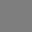

In [196]:
# initial generated image
(g_out32, g_out16, g_out8, g_out4) = generator.apply({'params': g_state.params, 'batch_stats': g_state.batch_stats}, jnp.array([jnp.zeros(shape=(1, LATENT_DIM))]), training=False)
display.display(Image.fromarray(np.array(input_to_image(g_out32[0]).astype(np.uint8))))
display.display(Image.fromarray(np.array(input_to_image(g_out16[0]).astype(np.uint8))))
display.display(Image.fromarray(np.array(input_to_image(g_out8[0]).astype(np.uint8))))
display.display(Image.fromarray(np.array(input_to_image(g_out4[0]).astype(np.uint8))))

In [197]:
print(train_ds.cardinality().numpy())
print(test_ds.cardinality().numpy())

-2
-2


Text(0, 0.5, 'Alpha (Weight)')

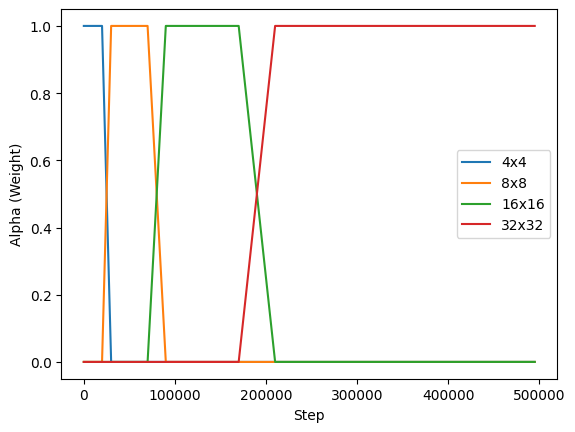

In [198]:
def get_alphas(step):
  # return (0.25, 0.25, 0.25, 0.25)
  if step >= 210_000:
    return (1., 0., 0., 0.)
  elif step >= 170_000:
    return ((step-170_000)/40_000, (210_000-step)/40_000, 0., 0.)
  elif step >= 90_000:
    return (0., 1., 0., 0.)
  elif step >= 70_000:
    return (0., (step-70_000)/20_000, (90_000-step)/20_000, 0.)
  elif step >= 30_000:
    return (0., 0., 1., 0.)
  elif step >= 20_000:
    return (0., 0., (step-20_000)/10_000, (30_000-step)/10_000)
  else:
    return (0., 0., 0., 1.)

X = [5000 * x for x in range(100)]
plt.plot(X, [get_alphas(x)[3] for x in X], label='4x4')
plt.plot(X, [get_alphas(x)[2] for x in X], label='8x8')
plt.plot(X, [get_alphas(x)[1] for x in X], label='16x16')
plt.plot(X, [get_alphas(x)[0] for x in X], label='32x32')
plt.legend()
plt.xlabel('Step')
plt.ylabel('Alpha (Weight)')

In [199]:
run_id = f'{int(time.time())}'
logdir = f'runs_{run_id}'
writer = SummaryWriter(logdir)
port = 6000 + int(time.time()) % 40
%load_ext tensorboard
%tensorboard --port={port} --logdir={logdir}

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [200]:
num_steps_per_checkpoint = 1000 // batch_size

for img in glob.glob("image*png"):
  os.remove(img)

for ckp in glob.glob("d_checkpoint_*.msgpack"):
  os.remove(ckp)

for ckp in glob.glob("g_checkpoint_*.msgpack"):
  os.remove(ckp)

latents = sample_latent(batch_size, key=jax.random.PRNGKey(0))

skipped_train_steps = 0
skipped_test_steps = 0

step = -1

In [ ]:
for batch in train_ds.as_numpy_iterator():
  step += 1

  if batch.shape[0] != batch_size:
    # TODO: figure out how to drop_remainder with disk + TFDS dataset
    skipped_train_steps += 1
    continue

  alphas = get_alphas(step)

  if step % num_steps_per_checkpoint == 0:
    (g_out32, g_out16, g_out8, g_out4) = generator.apply({'params': g_state.params, 'batch_stats': g_state.batch_stats}, latents, training=False)

    gen32 = np.array(input_to_image(g_out32).astype(np.uint8))
    gen16 = np.array(input_to_image(g_out16).astype(np.uint8))
    gen8 = np.array(input_to_image(g_out8).astype(np.uint8))
    gen4 = np.array(input_to_image(g_out4).astype(np.uint8))

    for (idx, img) in enumerate(gen32):
      Image.fromarray(img).save(f"image32_{step}_{idx}.png", "PNG")

    for (idx, img) in enumerate(gen16):
      Image.fromarray(img).save(f"image16_{step}_{idx}.png", "PNG")

    for (idx, img) in enumerate(gen8):
      Image.fromarray(img).save(f"image8_{step}_{idx}.png", "PNG")

    for (idx, img) in enumerate(gen4):
      Image.fromarray(img).save(f"image4_{step}_{idx}.png", "PNG")

    # Take expensive model and metric checkpoints rarely.
    if step % (100 * num_steps_per_checkpoint) != 0:
      continue

    d_train_metrics = d_state.metrics
    d_state = d_state.replace(metrics=DiscMetrics.empty())

    g_train_metrics = g_state.metrics
    g_state = g_state.replace(metrics=GenMetrics.empty())

    with open(f'd_checkpoint_{step}.msgpack', 'wb') as outfile:
      outfile.write(msgpack_serialize(to_state_dict(d_state)))
    with open(f'g_checkpoint_{step}.msgpack', 'wb') as outfile:
      outfile.write(msgpack_serialize(to_state_dict(g_state)))

    d_test_state = d_state
    d_state = d_state.replace(metrics=DiscMetrics.empty())

    g_test_state = g_state
    g_state = g_state.replace(metrics=GenMetrics.empty())

    for test_batch in test_ds.as_numpy_iterator():
      if test_batch.shape[0] != batch_size:
        # TODO: figure out how to drop_remainder with disk + TFDS dataset
        skipped_test_steps += 1
        continue
      d_test_state, g_test_state = compute_metrics(d_test_state, g_test_state, test_batch, alphas)

    writer.add_scalars('Discriminator/Loss', {'train': d_train_metrics.loss.compute().tolist(), 'test': d_test_state.metrics.loss.compute().tolist()}, step)
    writer.add_scalars('Discriminator/Accuracy', {'train': d_train_metrics.accuracy.compute().tolist(), 'test': d_test_state.metrics.accuracy.compute().tolist()}, step)

    writer.add_scalars('Generator/Loss', {'train': g_train_metrics.loss.compute().tolist(), 'test': g_test_state.metrics.loss.compute().tolist()}, step)
    writer.add_scalars('Generator/Accuracy', {'train': g_train_metrics.accuracy.compute().tolist(), 'test': g_test_state.metrics.accuracy.compute().tolist()}, step)

    writer.add_scalars('Prediction/Discriminator', {'train': d_train_metrics.prediction.compute().tolist(), 'test': d_test_state.metrics.prediction.compute().tolist()}, step)
    writer.add_scalars('Prediction/Generator', {'train': g_train_metrics.prediction.compute().tolist(), 'test': g_test_state.metrics.prediction.compute().tolist()}, step)

    writer.add_scalars('Alpha', {'32': alphas[0], '16': alphas[1], '8': alphas[2], '4': alphas[3]}, step)
    writer.add_scalars('Skipped Steps', {'train': skipped_train_steps, 'test': skipped_test_steps}, step)

    (real32, real16, real8, real4) = all_sizes(batch)

    real32 = np.array(input_to_image(real32).astype(np.uint8))
    real16 = np.array(input_to_image(real16).astype(np.uint8))
    real8 = np.array(input_to_image(real8).astype(np.uint8))
    real4 = np.array(input_to_image(real4).astype(np.uint8))

    writer.add_images("images32/real", real32, step, dataformats='NHWC')
    writer.add_images("images16/real", real16, step, dataformats='NHWC')
    writer.add_images("images8/real", real8, step, dataformats='NHWC')
    writer.add_images("images4/real", real4, step, dataformats='NHWC')

    writer.add_images("images32/generated", gen32, step, dataformats='NHWC')
    writer.add_images("images16/generated", gen16, step, dataformats='NHWC')
    writer.add_images("images8/generated", gen8, step, dataformats='NHWC')
    writer.add_images("images4/generated", gen4, step, dataformats='NHWC')

    writer.flush()

  d_state = disc_train_step(d_state, g_state, batch, alphas)

  if step % 5 == 0:
    g_state = gen_train_step(d_state, g_state, batch, alphas)

  (d_state, g_state) = compute_metrics(d_state, g_state, batch, alphas)

In [ ]:
print(step)

In [ ]:
!pip install -q ffmpegcv

In [ ]:
import cv2
import pandas as pd
import os
from google.colab import files
import ffmpegcv

for fil in sorted(glob.glob("*checkpoint*"), key=lambda x: -int(x.split('_')[2].split('.')[0]))[:6]:
  files.download(fil)

writer = ffmpegcv.VideoWriterNV(f"output_{run_id}.mp4", "h264", 30, (256, 256))

images = glob.glob("image*png")
df = pd.DataFrame(images, columns=["filename"])
df["step"] = df.filename.map(lambda x: int(x.split("_")[1]))
df["size"] = df.filename.map(lambda x: int(x.split("_")[0][len("image"):]))
df["idx"] = df.filename.map(lambda x: int(x.split("_")[2].split(".")[0]))

sorted_grouped = df.sort_values(["step", "size", "idx"]).groupby("step")

def format_step(step):
  if step < 1000:
    return f"{step}"
  elif step < 1000000:
    return f"{step/1000:.2f}K"
  else:
    return f"{step/1000000:.2f}M"

for step, group in sorted_grouped:
  if step % num_steps_per_checkpoint != 0:
    continue
  alphas = get_alphas(step)
  imgs32 = np.array([cv2.imread(fil) for fil in group[group["size"] == 32]["filename"]] # 64 x 32 x 32 x 3
                  ).reshape((8, 8, 32, 32, 3)).transpose(0, 2, 1, 3, 4).reshape(256, 256, 3)
  imgs16 = np.array(jax.image.resize(jnp.array([cv2.imread(fil) for fil in group[group["size"] == 16]["filename"]] # 64 x 16 x 16 x 3
                  ), shape=(64, 32, 32, 3), method="linear")).reshape((8, 8, 32, 32, 3)).transpose(0, 2, 1, 3, 4).reshape(256, 256, 3)
  imgs8 = np.array(jax.image.resize(jnp.array([cv2.imread(fil) for fil in group[group["size"] == 8]["filename"][:64]] # 64 x 8 x 8 x 3
                  ), shape=(64, 32, 32, 3), method="linear")).reshape((8, 8, 32, 32, 3)).transpose(0, 2, 1, 3, 4).reshape(256, 256, 3)
  imgs4 = np.array(jax.image.resize(jnp.array([cv2.imread(fil) for fil in group[group["size"] == 4]["filename"][:64]] # 64 x 4 x 4 x 3
                  ), shape=(64, 32, 32, 3), method="linear")).reshape((8, 8, 32, 32, 3)).transpose(0, 2, 1, 3, 4).reshape(256, 256, 3)
  footer1 = cv2.putText((255 * np.ones(shape=(24, 256, 3))).astype(np.uint8), f"Step {format_step(step)}", org=(100, 15), fontFace=cv2.FONT_HERSHEY_SIMPLEX, fontScale=0.4, color=(0, 0, 0))
  footer2 = cv2.putText((255 * np.ones(shape=(20, 256, 3))).astype(np.uint8), f"32x32: {alphas[0]:0.2f}  16x16: {alphas[1]:0.2f}", org=(50, 9), fontFace=cv2.FONT_HERSHEY_SIMPLEX, fontScale=0.35, color=(0, 0, 0))
  footer3 = cv2.putText((255 * np.ones(shape=(20, 256, 3))).astype(np.uint8), f"  8x8: {alphas[2]:0.2f}    4x4: {alphas[3]:0.2f}", org=(50, 9), fontFace=cv2.FONT_HERSHEY_SIMPLEX, fontScale=0.35, color=(0, 0, 0))
  imgs = (alphas[0]*imgs32 + alphas[1]*imgs16 + alphas[2]*imgs8 + alphas[3]*imgs4).astype(np.uint8)
  writer.write(np.concatenate([imgs[:192], footer1, footer2, footer3]))
writer.release()
files.download(f"output_{run_id}.mp4")
cv2.imwrite(f"generated_{run_id}.png", imgs)
files.download(f"generated_{run_id}.png")

In [ ]:
epsilon = 1e-8
x = 1.5 * jnp.ones((4, 8, 10, 3))
x / jnp.repeat(jnp.expand_dims((epsilon + (x**2).sum(axis=-1) / x.shape[-1])**0.5, axis=-1), repeats=x.shape[-1], axis=-1)

In [ ]:
!tar -cf gan_32_230804.tar *checkpoint* image*png